<a href="https://colab.research.google.com/github/jaivanti/syracuse/blob/main/SuperResolutionSubPixel_FINAL.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
import tensorflow as tf

import os
import math
import numpy as np

from tensorflow import keras
from tensorflow.keras import layers
from tensorflow.keras.preprocessing.image import load_img
from tensorflow.keras.preprocessing.image import array_to_img
from tensorflow.keras.preprocessing.image import img_to_array
from tensorflow.keras.preprocessing import image_dataset_from_directory

from IPython.display import display

In [2]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [3]:
root_dir = '/content/drive/MyDrive/tiny'

In [4]:
crop_size = 300
upscale_factor = 3
input_size = crop_size // upscale_factor
batch_size = 8

train_ds = image_dataset_from_directory(
    root_dir,
    batch_size=batch_size,
    image_size=(crop_size, crop_size),
    validation_split=0.2,
    subset="training",
    seed=1337,
    label_mode=None,
)

valid_ds = image_dataset_from_directory(
    root_dir,
    batch_size=batch_size,
    image_size=(crop_size, crop_size),
    validation_split=0.2,
    subset="validation",
    seed=1337,
    label_mode=None,
)

Found 1780 files belonging to 1 classes.
Using 1424 files for training.
Found 1780 files belonging to 1 classes.
Using 356 files for validation.


In [5]:

def scaling(input_image):
    input_image = input_image / 255.0
    return input_image


# Scale from (0, 255) to (0, 1)
train_ds = train_ds.map(scaling)
valid_ds = valid_ds.map(scaling)

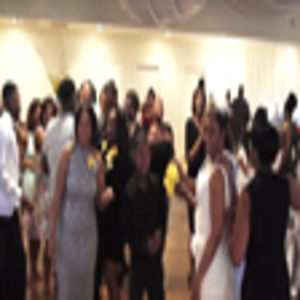

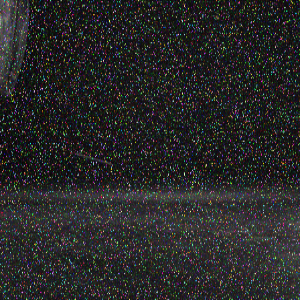

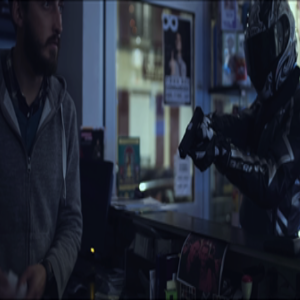

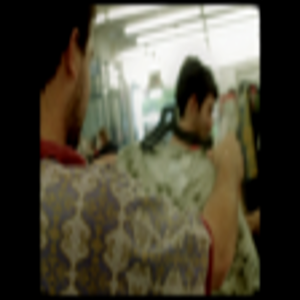

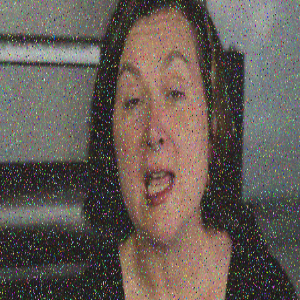

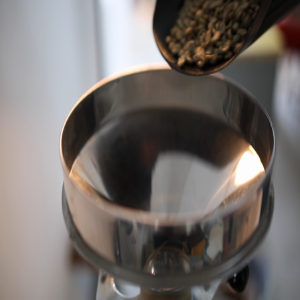

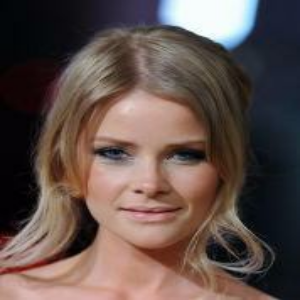

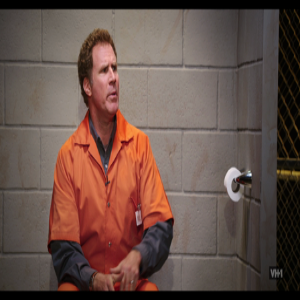

In [6]:
for batch in train_ds.take(1):
    for img in batch:
        display(array_to_img(img))

In [7]:
train_ds

<MapDataset shapes: (None, 300, 300, 3), types: tf.float32>

In [8]:
dataset = os.path.join(root_dir, "images")
test_path = os.path.join(dataset, "test")
#test_path_f = os.path.join(test_path, ) 

test_img_paths = sorted(
    [
        os.path.join(test_path, fname)
        for fname in os.listdir(test_path)
        if fname.endswith(".png")
    ]
)

In [9]:
len(test_img_paths)

56

In [10]:
root_dir

'/content/drive/MyDrive/tiny'

In [11]:
test_path

'/content/drive/MyDrive/tiny/images/test'

In [12]:
train_ds

<MapDataset shapes: (None, 300, 300, 3), types: tf.float32>

In [13]:
valid_ds  

<MapDataset shapes: (None, 300, 300, 3), types: tf.float32>

In [14]:

# Use TF Ops to process.
def process_input(input, input_size, upscale_factor):
    input = tf.image.rgb_to_yuv(input)
    last_dimension_axis = len(input.shape) - 1
    y, u, v = tf.split(input, 3, axis=last_dimension_axis)
    return tf.image.resize(y, [input_size, input_size], method="area")


def process_target(input):
    input = tf.image.rgb_to_yuv(input)
    last_dimension_axis = len(input.shape) - 1
    y, u, v = tf.split(input, 3, axis=last_dimension_axis)
    return y


In [15]:

train_ds = train_ds.map(
    lambda x: (process_input(x, input_size, upscale_factor), process_target(x))
)
train_ds = train_ds.prefetch(buffer_size=32)

valid_ds = valid_ds.map(
    lambda x: (process_input(x, input_size, upscale_factor), process_target(x))
)
valid_ds = valid_ds.prefetch(buffer_size=32)

In [16]:
train_ds

<PrefetchDataset shapes: ((None, 100, 100, 1), (None, 300, 300, 1)), types: (tf.float32, tf.float32)>

In [17]:
valid_ds

<PrefetchDataset shapes: ((None, 100, 100, 1), (None, 300, 300, 1)), types: (tf.float32, tf.float32)>

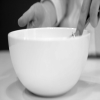

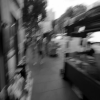

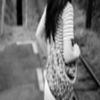

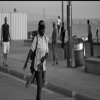

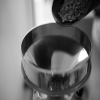

...

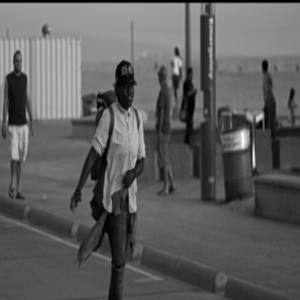

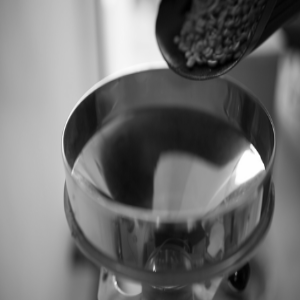

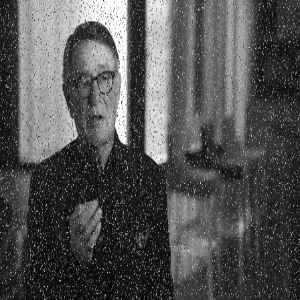

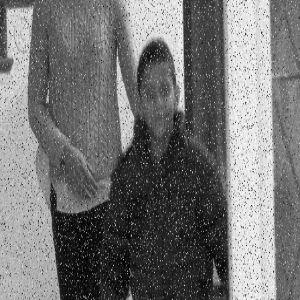

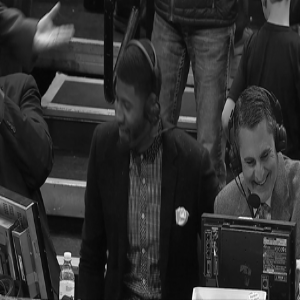

In [18]:
for batch in train_ds.take(1):
    for img in batch[0]:
        display(array_to_img(img))
    for img in batch[1]:
        display(array_to_img(img))

In [19]:

def get_model(upscale_factor=3, channels=1):
    conv_args = {
        "activation": "relu",
        "kernel_initializer": "Orthogonal",
        "padding": "same",
    }
    inputs = keras.Input(shape=(None, None, channels))
    x = layers.Conv2D(64, 5, **conv_args)(inputs)
    x = layers.Conv2D(64, 3, **conv_args)(x)
    x = layers.Conv2D(32, 3, **conv_args)(x)
    x = layers.Conv2D(channels * (upscale_factor ** 2), 3, **conv_args)(x)
    outputs = tf.nn.depth_to_space(x, upscale_factor)
    print("w")
    return keras.Model(inputs, outputs)


In [20]:
import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1.inset_locator import zoomed_inset_axes
from mpl_toolkits.axes_grid1.inset_locator import mark_inset
import PIL


def plot_results(img, prefix, title):
    """Plot the result with zoom-in area."""
    img_array = img_to_array(img)
    img_array = img_array.astype("float32") / 255.0

    # Create a new figure with a default 111 subplot.
    fig, ax = plt.subplots()
    im = ax.imshow(img_array[::-1], origin="lower")

    plt.title(title)
    # zoom-factor: 2.0, location: upper-left
    axins = zoomed_inset_axes(ax, 2, loc=2)
    axins.imshow(img_array[::-1], origin="lower")

    # Specify the limits.
    x1, x2, y1, y2 = 200, 300, 100, 200
    # Apply the x-limits.
    axins.set_xlim(x1, x2)
    # Apply the y-limits.
    axins.set_ylim(y1, y2)

    plt.yticks(visible=False)
    plt.xticks(visible=False)

    # Make the line.
    mark_inset(ax, axins, loc1=1, loc2=3, fc="none", ec="blue")
    plt.savefig(str(prefix) + "-" + title + ".png")
    plt.show()


def get_lowres_image(img, upscale_factor):
    """Return low-resolution image to use as model input."""
    return img.resize(
        (img.size[0] // upscale_factor, img.size[1] // upscale_factor),
        PIL.Image.BICUBIC,
    )


def upscale_image(model, img):
    """Predict the result based on input image and restore the image as RGB."""
    ycbcr = img.convert("YCbCr")
    y, cb, cr = ycbcr.split()
    y = img_to_array(y)
    y = y.astype("float32") / 255.0

    input = np.expand_dims(y, axis=0)
    out = model.predict(input)

    out_img_y = out[0]
    out_img_y *= 255.0

    # Restore the image in RGB color space.
    out_img_y = out_img_y.clip(0, 255)
    out_img_y = out_img_y.reshape((np.shape(out_img_y)[0], np.shape(out_img_y)[1]))
    out_img_y = PIL.Image.fromarray(np.uint8(out_img_y), mode="L")
    out_img_cb = cb.resize(out_img_y.size, PIL.Image.BICUBIC)
    out_img_cr = cr.resize(out_img_y.size, PIL.Image.BICUBIC)
    out_img = PIL.Image.merge("YCbCr", (out_img_y, out_img_cb, out_img_cr)).convert(
        "RGB"
    )
    return out_img


In [21]:

class ESPCNCallback(keras.callbacks.Callback):
    def __init__(self):
        super(ESPCNCallback, self).__init__()
        self.test_img = get_lowres_image(load_img(test_img_paths[0]), upscale_factor)

    # Store PSNR value in each epoch.
    def on_epoch_begin(self, epoch, logs=None):
        self.psnr = []

    def on_epoch_end(self, epoch, logs=None):
        print("Mean PSNR for epoch: %.2f" % (np.mean(self.psnr)))
        if epoch % 20 == 0:
            prediction = upscale_image(self.model, self.test_img)
            plot_results(prediction, "epoch-" + str(epoch), "prediction")

    def on_test_batch_end(self, batch, logs=None):
        self.psnr.append(10 * math.log10(1 / logs["loss"]))


In [22]:
len(train_ds)

178

In [23]:
early_stopping_callback = keras.callbacks.EarlyStopping(monitor="loss", patience=10)

checkpoint_filepath = "/tmp/checkpoint"

model_checkpoint_callback = keras.callbacks.ModelCheckpoint(
    filepath=checkpoint_filepath,
    save_weights_only=True,
    monitor="loss",
    mode="min",
    save_best_only=True,
)

model = get_model(upscale_factor=upscale_factor, channels=1)
model.summary()

callbacks = [ESPCNCallback(), early_stopping_callback, model_checkpoint_callback]
loss_fn = keras.losses.MeanSquaredError()
optimizer = keras.optimizers.Adam(learning_rate=0.001)

w
Model: "model"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         [(None, None, None, 1)]   0         
_________________________________________________________________
conv2d (Conv2D)              (None, None, None, 64)    1664      
_________________________________________________________________
conv2d_1 (Conv2D)            (None, None, None, 64)    36928     
_________________________________________________________________
conv2d_2 (Conv2D)            (None, None, None, 32)    18464     
_________________________________________________________________
conv2d_3 (Conv2D)            (None, None, None, 9)     2601      
_________________________________________________________________
tf.nn.depth_to_space (TFOpLa (None, None, None, 1)     0         
Total params: 59,657
Trainable params: 59,657
Non-trainable params: 0
_______________________________________________________

Epoch 1/50
178/178 - 292s - loss: 0.0125 - val_loss: 0.0025
Mean PSNR for epoch: 25.75


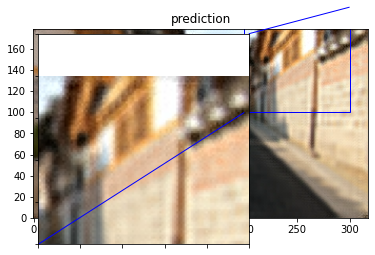

Epoch 2/50
178/178 - 178s - loss: 0.0023 - val_loss: 0.0022
Mean PSNR for epoch: 26.49
Epoch 3/50
178/178 - 177s - loss: 0.0020 - val_loss: 0.0021
Mean PSNR for epoch: 26.86
Epoch 4/50
178/178 - 178s - loss: 0.0020 - val_loss: 0.0022
Mean PSNR for epoch: 26.72
Epoch 5/50
178/178 - 178s - loss: 0.0020 - val_loss: 0.0020
Mean PSNR for epoch: 26.95
Epoch 6/50
178/178 - 178s - loss: 0.0020 - val_loss: 0.0020
Mean PSNR for epoch: 26.91
Epoch 7/50
178/178 - 178s - loss: 0.0022 - val_loss: 0.0020
Mean PSNR for epoch: 26.77
Epoch 8/50
178/178 - 178s - loss: 0.0019 - val_loss: 0.0020
Mean PSNR for epoch: 26.70
Epoch 9/50
178/178 - 178s - loss: 0.0019 - val_loss: 0.0020
Mean PSNR for epoch: 26.88
Epoch 10/50
178/178 - 178s - loss: 0.0019 - val_loss: 0.0020
Mean PSNR for epoch: 27.00
Epoch 11/50
178/178 - 178s - loss: 0.0019 - val_loss: 0.0020
Mean PSNR for epoch: 26.90
Epoch 12/50
178/178 - 178s - loss: 0.0020 - val_loss: 0.0021
Mean PSNR for epoch: 26.92
Epoch 13/50
178/178 - 178s - loss: 0.001

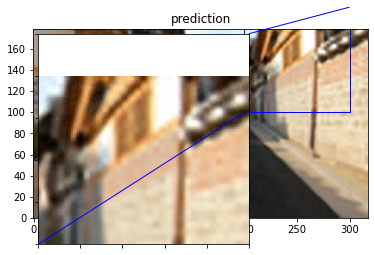

Epoch 22/50
178/178 - 180s - loss: 0.0019 - val_loss: 0.0020
Mean PSNR for epoch: 27.09
Epoch 23/50
178/178 - 180s - loss: 0.0019 - val_loss: 0.0020
Mean PSNR for epoch: 27.17
Epoch 24/50
178/178 - 180s - loss: 0.0019 - val_loss: 0.0021
Mean PSNR for epoch: 26.91
Epoch 25/50
178/178 - 180s - loss: 0.0019 - val_loss: 0.0020
Mean PSNR for epoch: 27.37
Epoch 26/50
178/178 - 180s - loss: 0.0019 - val_loss: 0.0021
Mean PSNR for epoch: 26.76
Epoch 27/50
178/178 - 180s - loss: 0.0019 - val_loss: 0.0020
Mean PSNR for epoch: 27.20
Epoch 28/50
178/178 - 180s - loss: 0.0019 - val_loss: 0.0020
Mean PSNR for epoch: 26.98
Epoch 29/50
178/178 - 180s - loss: 0.0019 - val_loss: 0.0020
Mean PSNR for epoch: 27.08
Epoch 30/50
178/178 - 180s - loss: 0.0025 - val_loss: 0.0020
Mean PSNR for epoch: 26.83
Epoch 31/50
178/178 - 180s - loss: 0.0019 - val_loss: 0.0020
Mean PSNR for epoch: 27.01
Epoch 32/50
178/178 - 180s - loss: 0.0019 - val_loss: 0.0020
Mean PSNR for epoch: 26.98
Epoch 33/50
178/178 - 180s - los

In [25]:
import time
start = time.time()
epochs = 50

model.compile(
    optimizer=optimizer, loss=loss_fn,)

model.fit(
    train_ds, epochs=epochs, callbacks=callbacks, validation_data=valid_ds, verbose=2
)

# The model weights (that are considered the best) are loaded into the model.
model.load_weights(checkpoint_filepath)

PSNR of low resolution image and high resolution image is 26.2181
SSIM of low resolution image and high resolution image is 0.7914
PSNR of predict and high resolution is 27.0007
PSNR of predict and high resolution is 0.8130


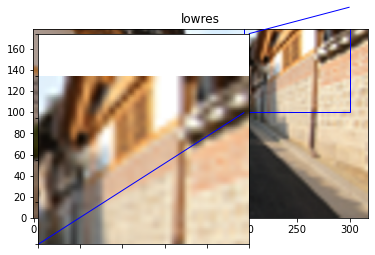

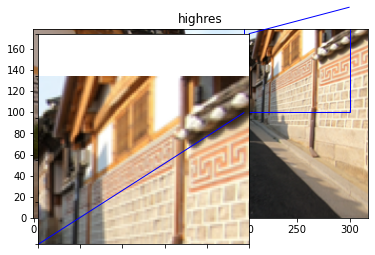

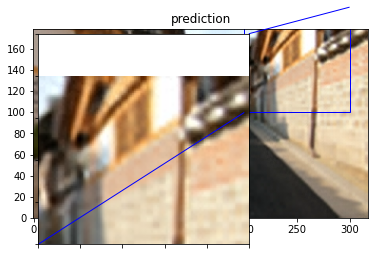

PSNR of low resolution image and high resolution image is 34.2073
SSIM of low resolution image and high resolution image is 0.9515
PSNR of predict and high resolution is 35.1033
PSNR of predict and high resolution is 0.9556


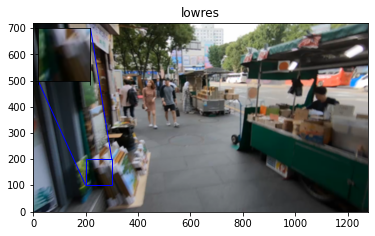

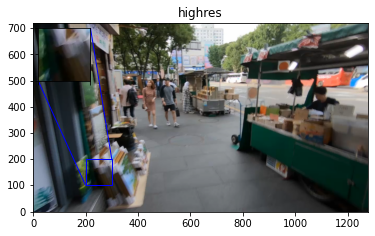

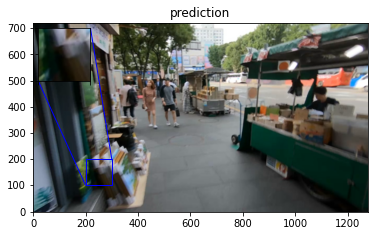

PSNR of low resolution image and high resolution image is 26.7463
SSIM of low resolution image and high resolution image is 0.8093
PSNR of predict and high resolution is 27.5310
PSNR of predict and high resolution is 0.8287


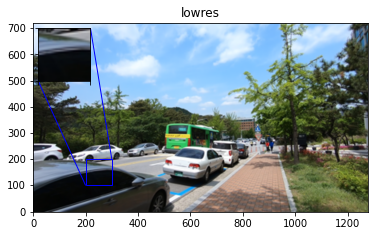

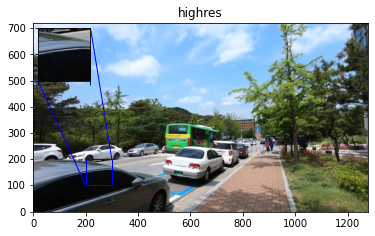

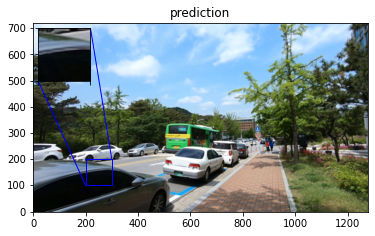

PSNR of low resolution image and high resolution image is 28.0020
SSIM of low resolution image and high resolution image is 0.8255
PSNR of predict and high resolution is 28.8594
PSNR of predict and high resolution is 0.8445


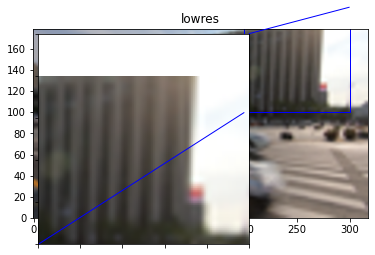

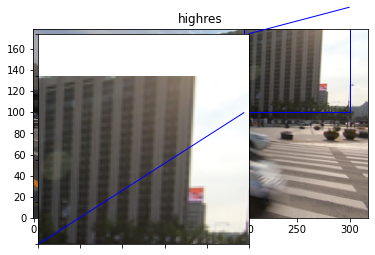

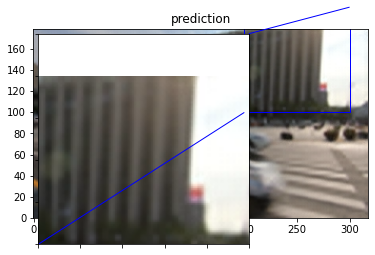

PSNR of low resolution image and high resolution image is 26.5682
SSIM of low resolution image and high resolution image is 0.8067
PSNR of predict and high resolution is 27.3835
PSNR of predict and high resolution is 0.8275


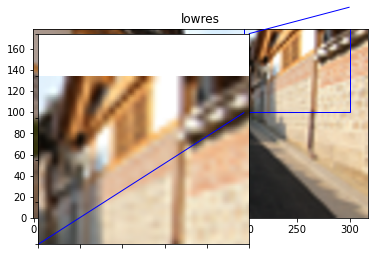

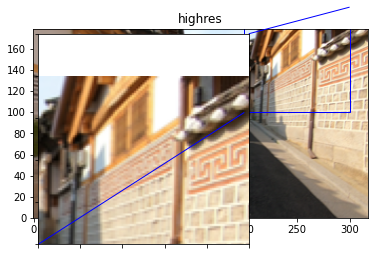

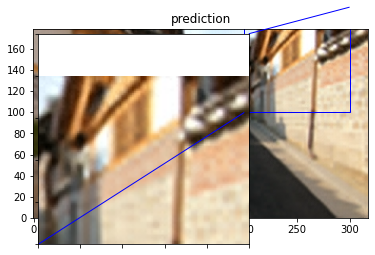

PSNR of low resolution image and high resolution image is 33.5683
SSIM of low resolution image and high resolution image is 0.9415
PSNR of predict and high resolution is 34.4468
PSNR of predict and high resolution is 0.9464


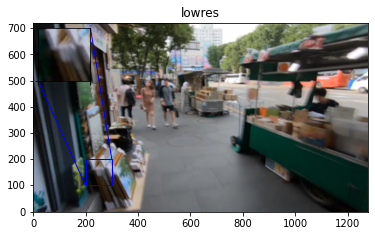

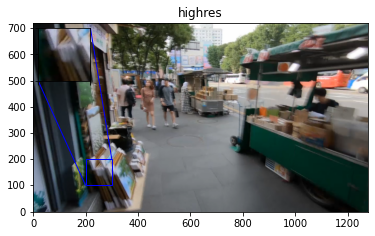

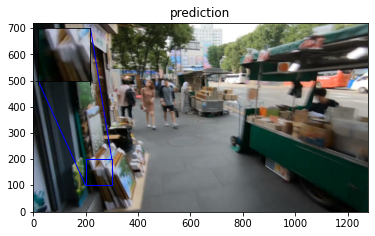

PSNR of low resolution image and high resolution image is 27.0851
SSIM of low resolution image and high resolution image is 0.8105
PSNR of predict and high resolution is 27.8577
PSNR of predict and high resolution is 0.8275


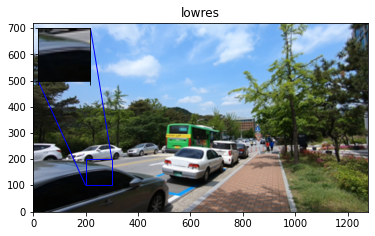

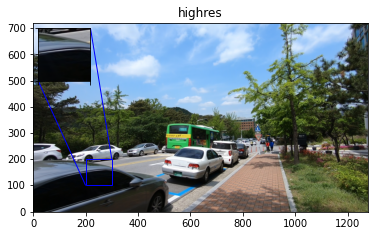

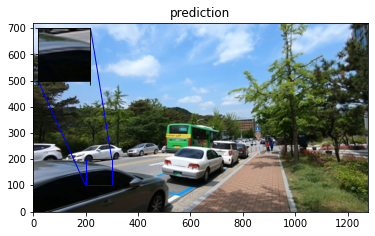

PSNR of low resolution image and high resolution image is 27.9896
SSIM of low resolution image and high resolution image is 0.8282
PSNR of predict and high resolution is 28.8522
PSNR of predict and high resolution is 0.8460


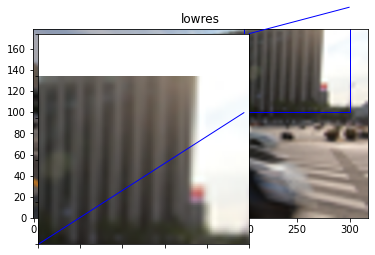

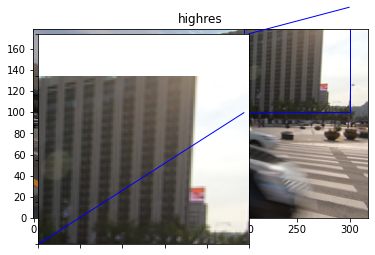

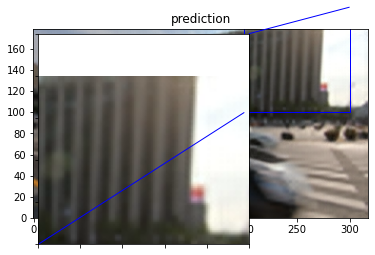

PSNR of low resolution image and high resolution image is 27.2976
SSIM of low resolution image and high resolution image is 0.8206
PSNR of predict and high resolution is 28.2213
PSNR of predict and high resolution is 0.8419


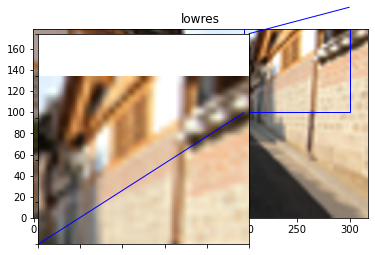

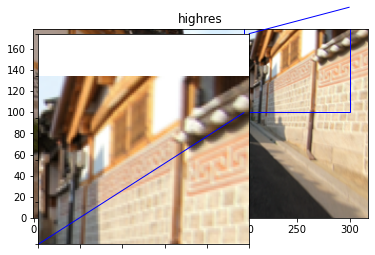

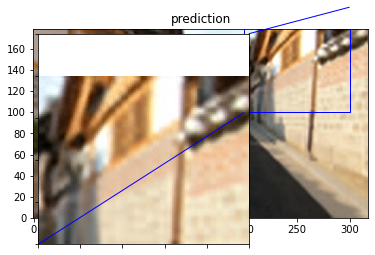

PSNR of low resolution image and high resolution image is 40.3991
SSIM of low resolution image and high resolution image is 0.9754
PSNR of predict and high resolution is 40.1363
PSNR of predict and high resolution is 0.9732


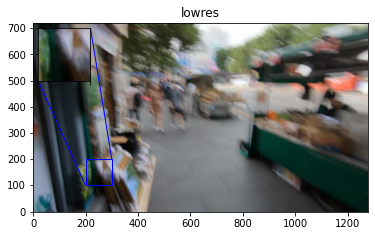

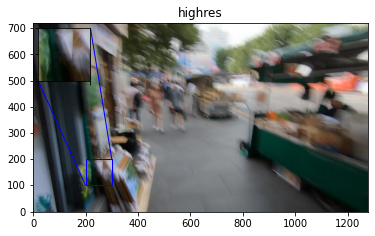

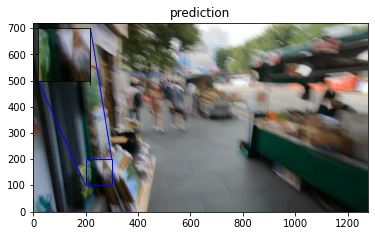

PSNR of low resolution image and high resolution image is 27.3210
SSIM of low resolution image and high resolution image is 0.8119
PSNR of predict and high resolution is 28.0944
PSNR of predict and high resolution is 0.8277


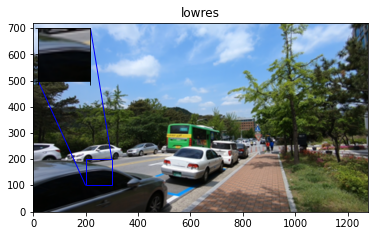

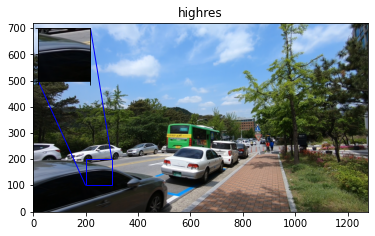

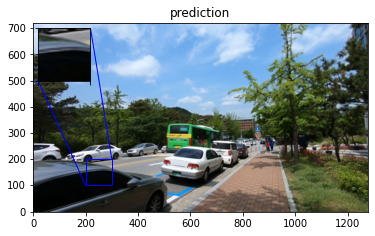

PSNR of low resolution image and high resolution image is 28.1444
SSIM of low resolution image and high resolution image is 0.8358
PSNR of predict and high resolution is 28.9949
PSNR of predict and high resolution is 0.8532


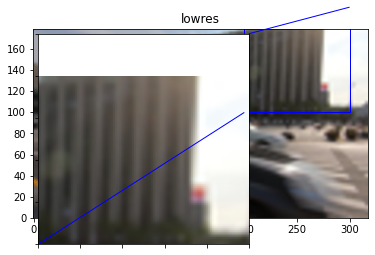

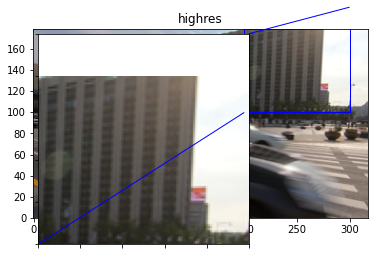

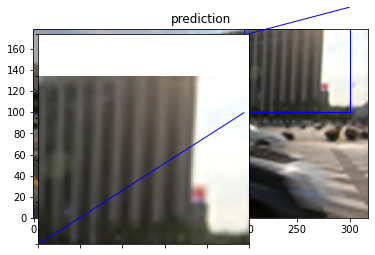

PSNR of low resolution image and high resolution image is 28.1394
SSIM of low resolution image and high resolution image is 0.8490
PSNR of predict and high resolution is 29.0202
PSNR of predict and high resolution is 0.8656


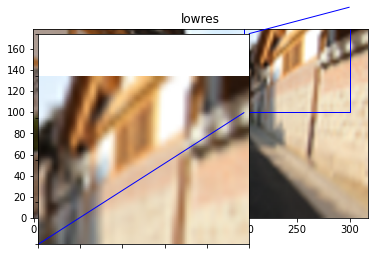

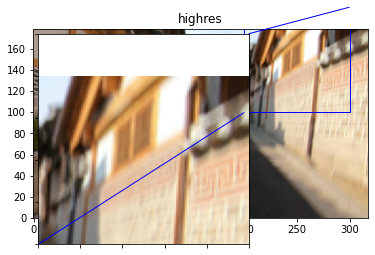

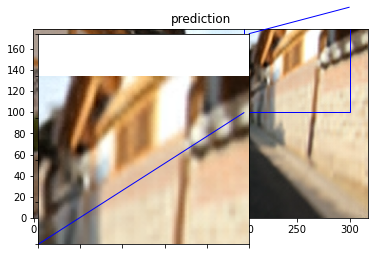

PSNR of low resolution image and high resolution image is 42.4061
SSIM of low resolution image and high resolution image is 0.9848
PSNR of predict and high resolution is 41.3948
PSNR of predict and high resolution is 0.9813


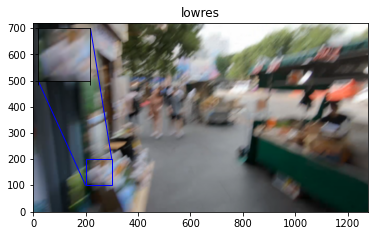

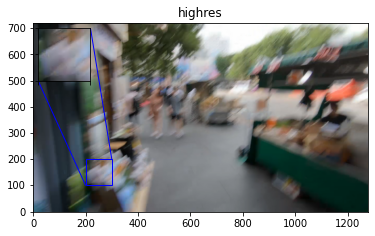

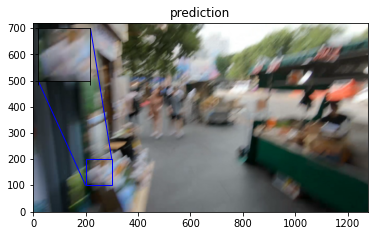

PSNR of low resolution image and high resolution image is 27.6952
SSIM of low resolution image and high resolution image is 0.8172
PSNR of predict and high resolution is 28.4944
PSNR of predict and high resolution is 0.8324


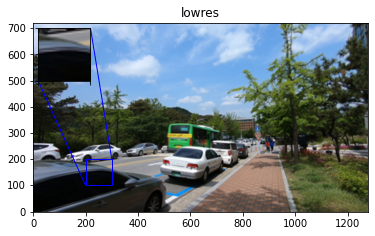

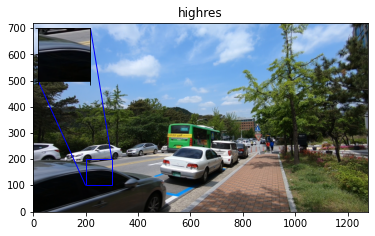

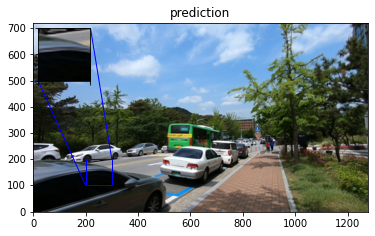

PSNR of low resolution image and high resolution image is 28.2753
SSIM of low resolution image and high resolution image is 0.8390
PSNR of predict and high resolution is 29.1219
PSNR of predict and high resolution is 0.8564


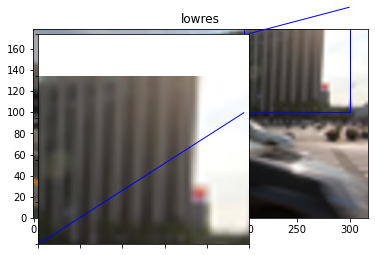

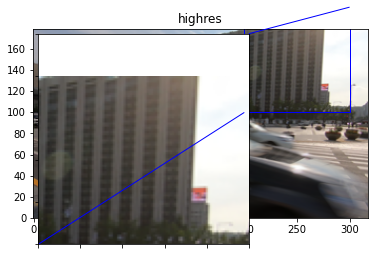

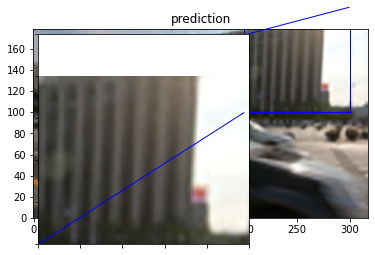

PSNR of low resolution image and high resolution image is 30.2496
SSIM of low resolution image and high resolution image is 0.8910
PSNR of predict and high resolution is 31.2947
PSNR of predict and high resolution is 0.9017


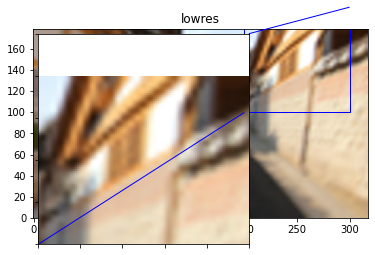

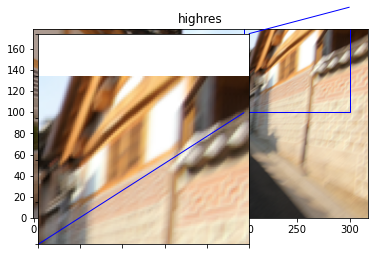

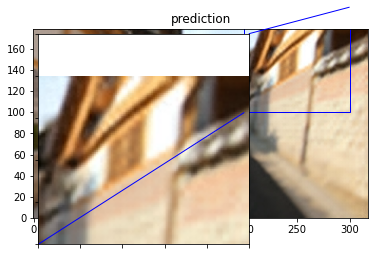

PSNR of low resolution image and high resolution image is 42.9554
SSIM of low resolution image and high resolution image is 0.9851
PSNR of predict and high resolution is 41.8823
PSNR of predict and high resolution is 0.9816


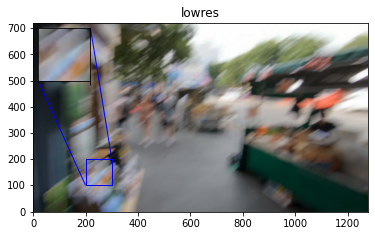

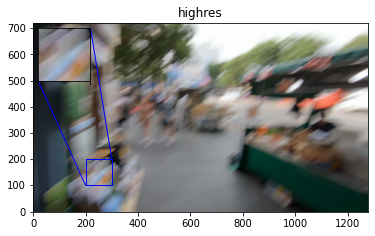

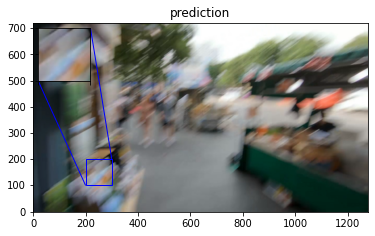

PSNR of low resolution image and high resolution image is 27.6376
SSIM of low resolution image and high resolution image is 0.8149
PSNR of predict and high resolution is 28.4125
PSNR of predict and high resolution is 0.8302


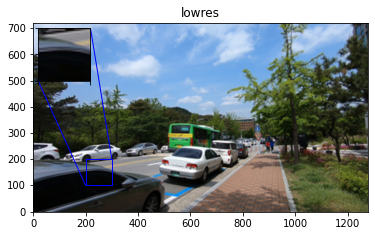

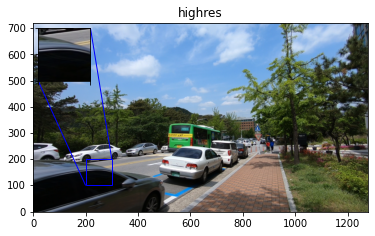

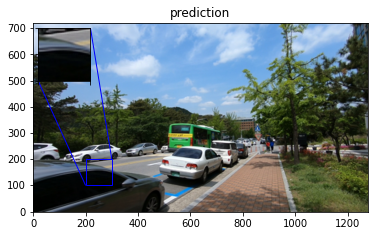

PSNR of low resolution image and high resolution image is 28.4279
SSIM of low resolution image and high resolution image is 0.8430
PSNR of predict and high resolution is 29.2581
PSNR of predict and high resolution is 0.8594


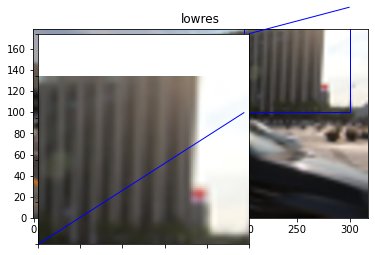

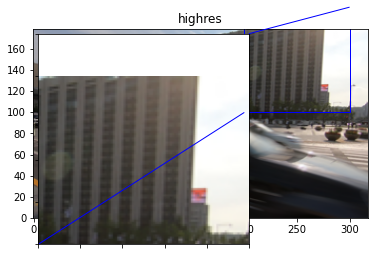

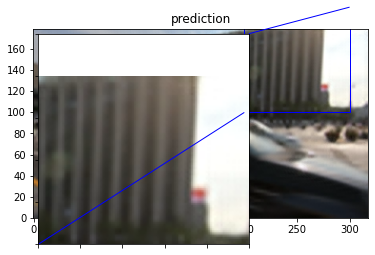

PSNR of low resolution image and high resolution image is 26.4238
SSIM of low resolution image and high resolution image is 0.7946
PSNR of predict and high resolution is 27.3964
PSNR of predict and high resolution is 0.8210


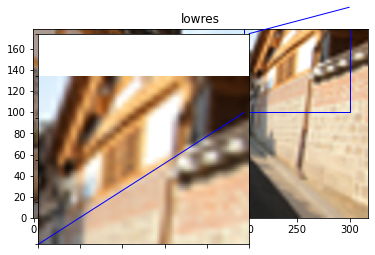

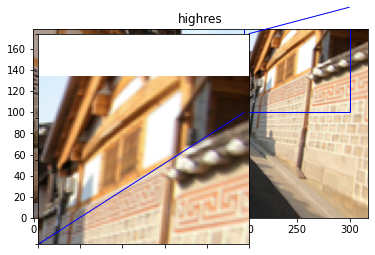

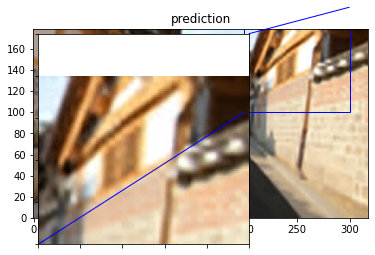

PSNR of low resolution image and high resolution image is 40.3587
SSIM of low resolution image and high resolution image is 0.9785
PSNR of predict and high resolution is 40.2863
PSNR of predict and high resolution is 0.9764


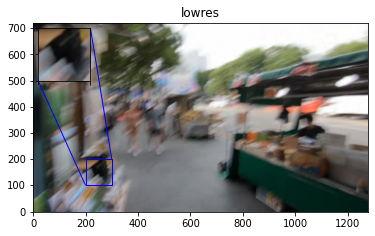

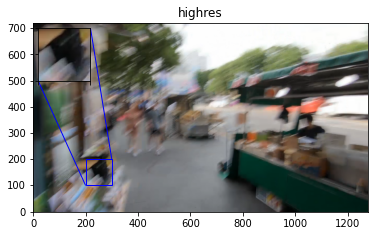

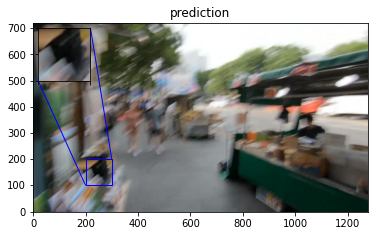

PSNR of low resolution image and high resolution image is 27.6785
SSIM of low resolution image and high resolution image is 0.8146
PSNR of predict and high resolution is 28.4417
PSNR of predict and high resolution is 0.8296


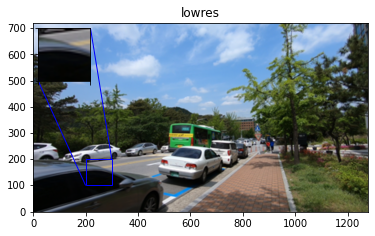

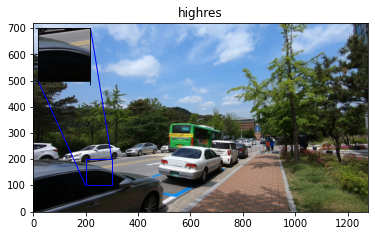

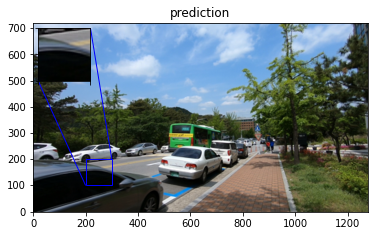

PSNR of low resolution image and high resolution image is 28.5675
SSIM of low resolution image and high resolution image is 0.8450
PSNR of predict and high resolution is 29.4097
PSNR of predict and high resolution is 0.8622


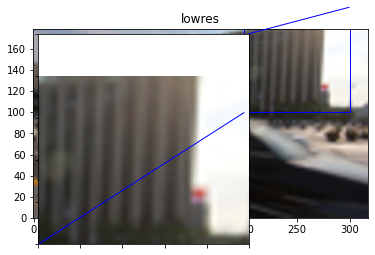

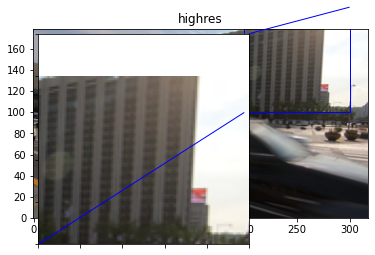

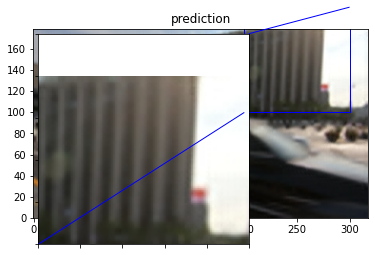

PSNR of low resolution image and high resolution image is 26.9192
SSIM of low resolution image and high resolution image is 0.8144
PSNR of predict and high resolution is 27.9196
PSNR of predict and high resolution is 0.8387


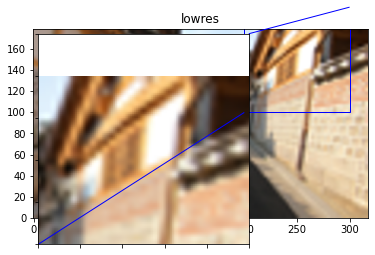

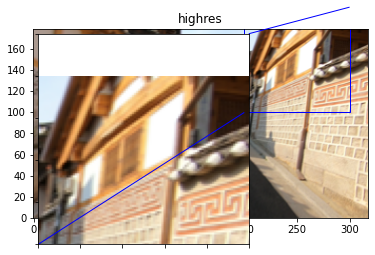

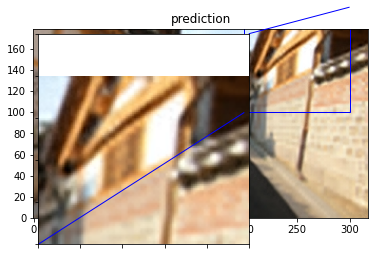

PSNR of low resolution image and high resolution image is 36.1239
SSIM of low resolution image and high resolution image is 0.9581
PSNR of predict and high resolution is 36.8082
PSNR of predict and high resolution is 0.9601


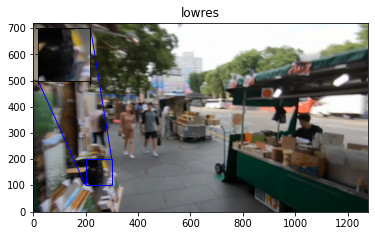

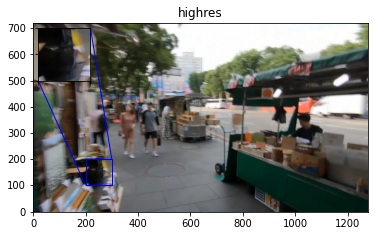

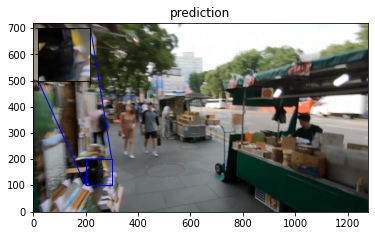

PSNR of low resolution image and high resolution image is 27.7183
SSIM of low resolution image and high resolution image is 0.8186
PSNR of predict and high resolution is 28.4650
PSNR of predict and high resolution is 0.8331


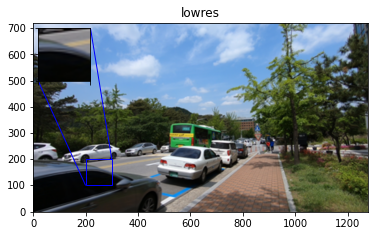

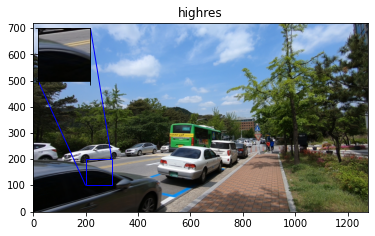

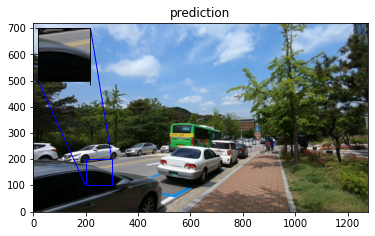

PSNR of low resolution image and high resolution image is 28.6949
SSIM of low resolution image and high resolution image is 0.8496
PSNR of predict and high resolution is 29.5224
PSNR of predict and high resolution is 0.8661


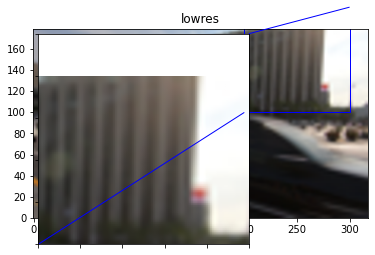

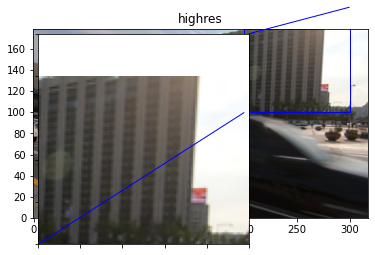

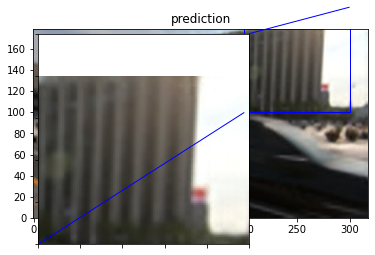

PSNR of low resolution image and high resolution image is 27.7663
SSIM of low resolution image and high resolution image is 0.8419
PSNR of predict and high resolution is 28.7587
PSNR of predict and high resolution is 0.8608


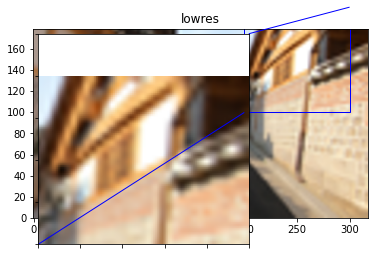

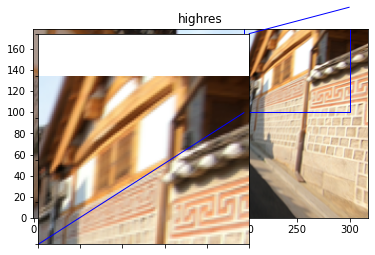

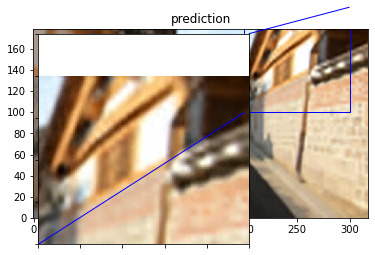

PSNR of low resolution image and high resolution image is 40.5847
SSIM of low resolution image and high resolution image is 0.9791
PSNR of predict and high resolution is 40.2808
PSNR of predict and high resolution is 0.9764


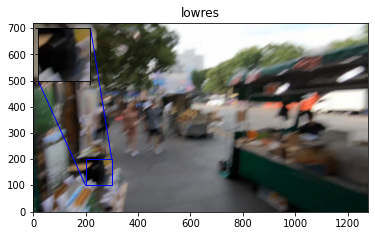

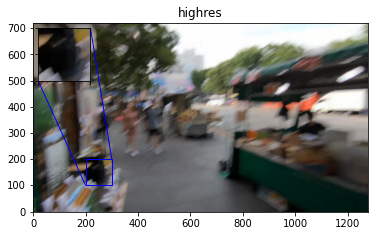

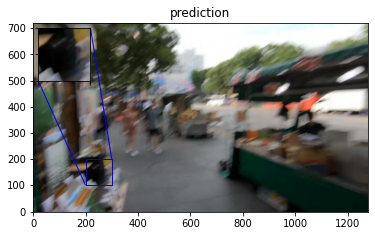

PSNR of low resolution image and high resolution image is 27.7254
SSIM of low resolution image and high resolution image is 0.8185
PSNR of predict and high resolution is 28.4873
PSNR of predict and high resolution is 0.8330


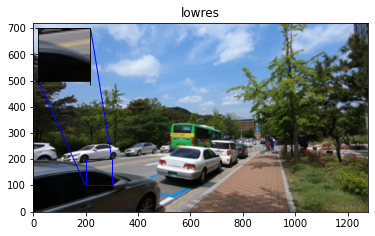

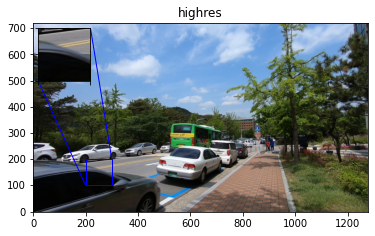

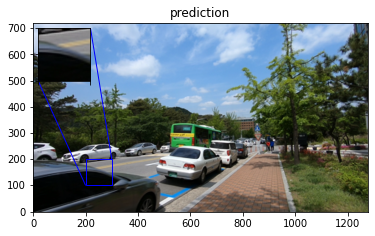

PSNR of low resolution image and high resolution image is 28.9779
SSIM of low resolution image and high resolution image is 0.8549
PSNR of predict and high resolution is 29.8505
PSNR of predict and high resolution is 0.8711


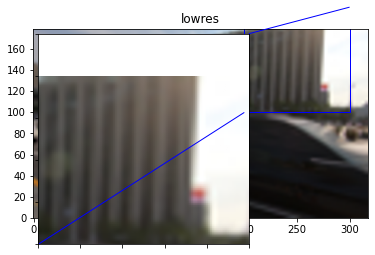

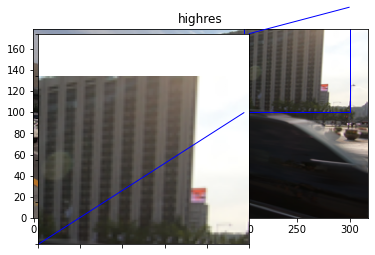

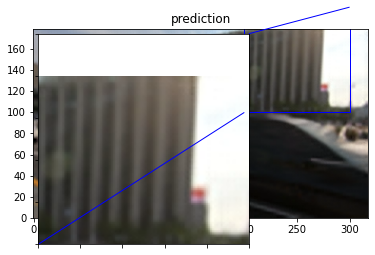

PSNR of low resolution image and high resolution image is 27.6545
SSIM of low resolution image and high resolution image is 0.8425
PSNR of predict and high resolution is 28.7328
PSNR of predict and high resolution is 0.8631


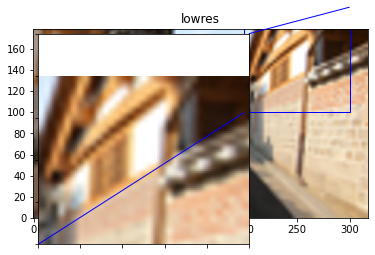

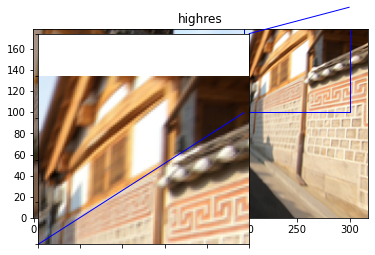

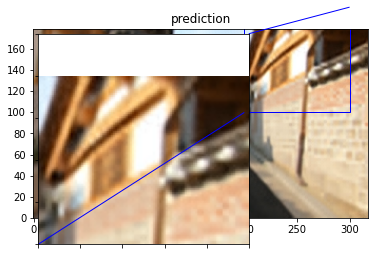

PSNR of low resolution image and high resolution image is 39.8183
SSIM of low resolution image and high resolution image is 0.9777
PSNR of predict and high resolution is 39.7994
PSNR of predict and high resolution is 0.9753


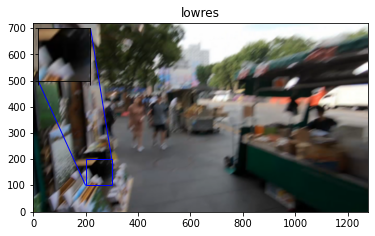

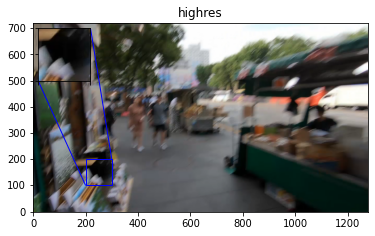

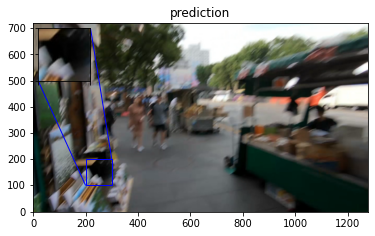

PSNR of low resolution image and high resolution image is 27.7612
SSIM of low resolution image and high resolution image is 0.8205
PSNR of predict and high resolution is 28.5421
PSNR of predict and high resolution is 0.8353


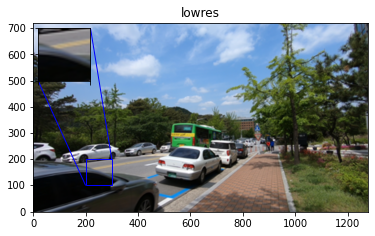

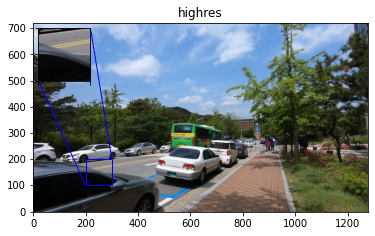

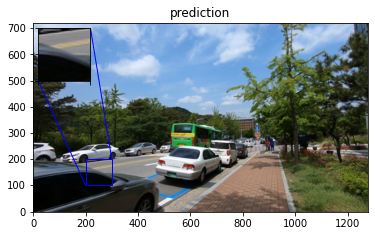

PSNR of low resolution image and high resolution image is 29.2347
SSIM of low resolution image and high resolution image is 0.8582
PSNR of predict and high resolution is 30.1823
PSNR of predict and high resolution is 0.8750


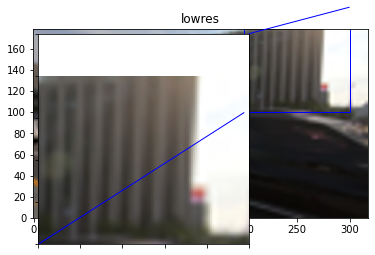

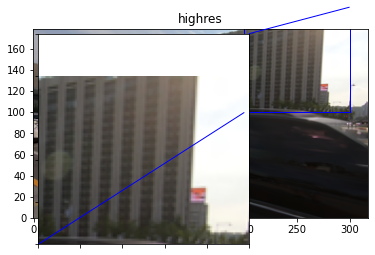

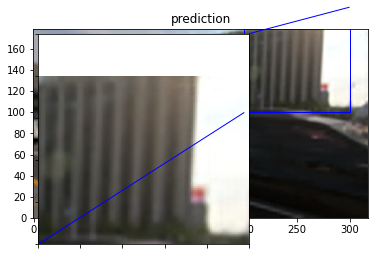

PSNR of low resolution image and high resolution image is 28.1739
SSIM of low resolution image and high resolution image is 0.8437
PSNR of predict and high resolution is 29.0836
PSNR of predict and high resolution is 0.8607


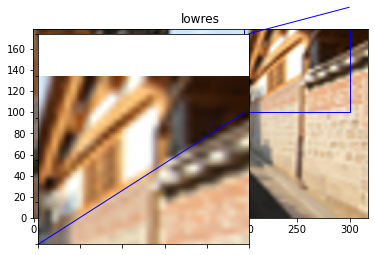

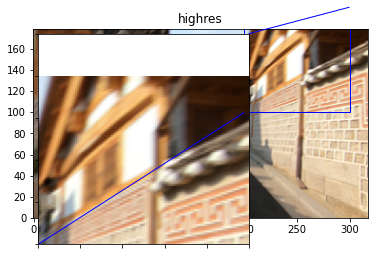

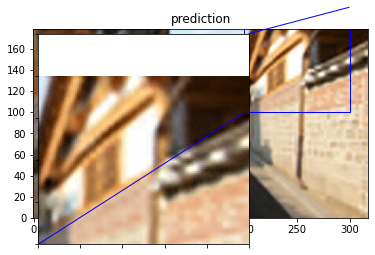

PSNR of low resolution image and high resolution image is 40.4422
SSIM of low resolution image and high resolution image is 0.9783
PSNR of predict and high resolution is 40.3641
PSNR of predict and high resolution is 0.9761


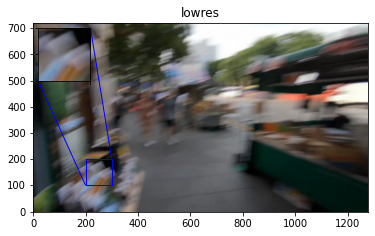

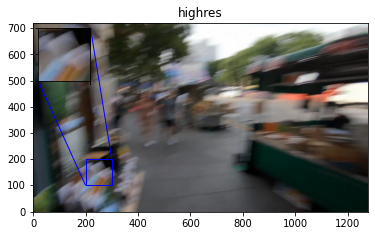

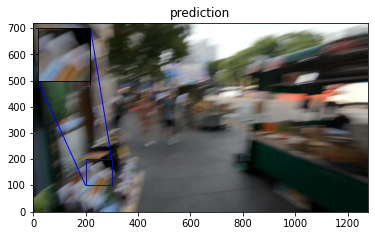

PSNR of low resolution image and high resolution image is 27.7233
SSIM of low resolution image and high resolution image is 0.8194
PSNR of predict and high resolution is 28.4995
PSNR of predict and high resolution is 0.8344


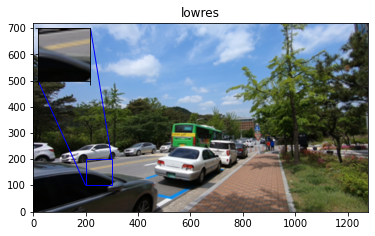

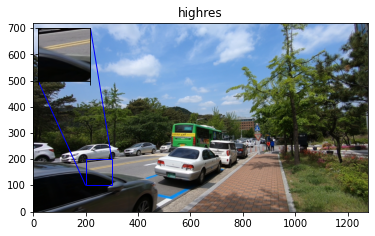

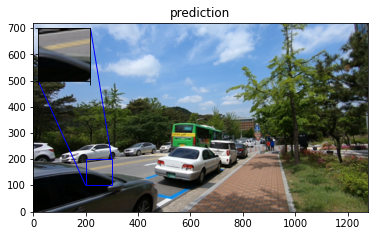

PSNR of low resolution image and high resolution image is 29.2347
SSIM of low resolution image and high resolution image is 0.8588
PSNR of predict and high resolution is 30.2085
PSNR of predict and high resolution is 0.8761


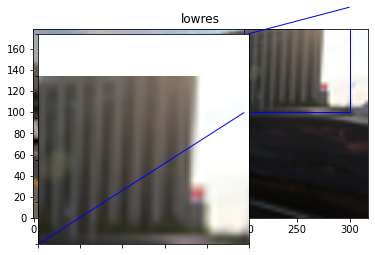

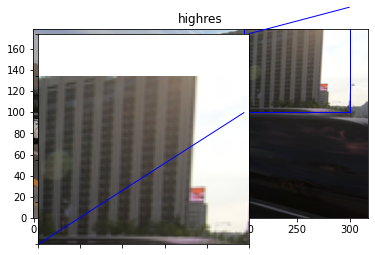

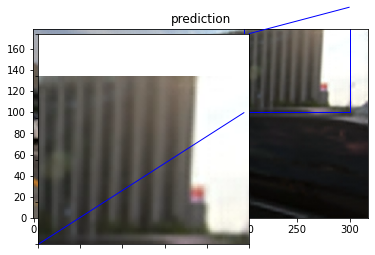

PSNR of low resolution image and high resolution image is 26.9962
SSIM of low resolution image and high resolution image is 0.8139
PSNR of predict and high resolution is 27.9788
PSNR of predict and high resolution is 0.8363


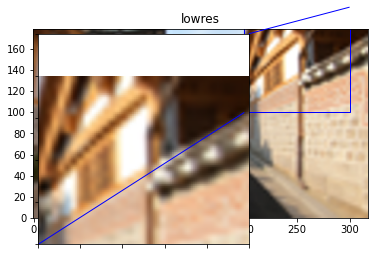

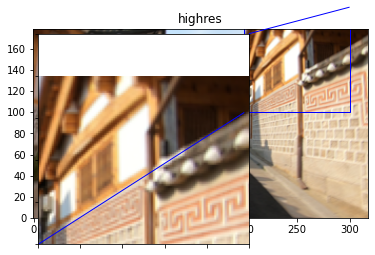

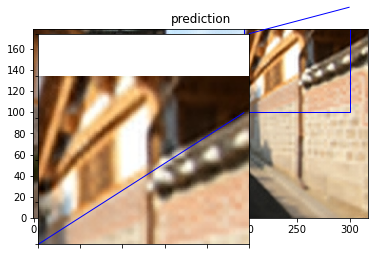

PSNR of low resolution image and high resolution image is 37.4832
SSIM of low resolution image and high resolution image is 0.9595
PSNR of predict and high resolution is 37.8729
PSNR of predict and high resolution is 0.9597


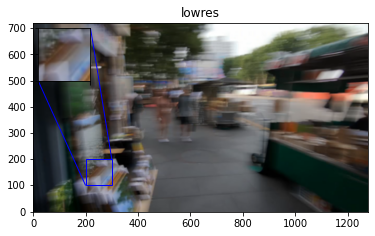

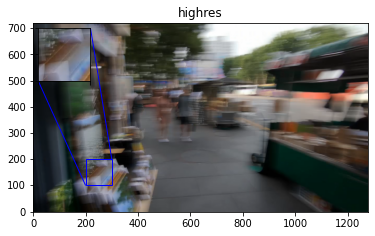

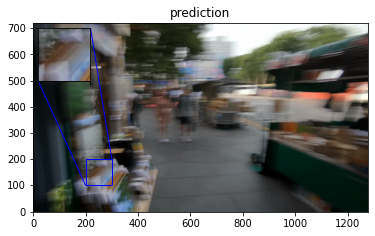

PSNR of low resolution image and high resolution image is 27.7130
SSIM of low resolution image and high resolution image is 0.8162
PSNR of predict and high resolution is 28.5015
PSNR of predict and high resolution is 0.8317


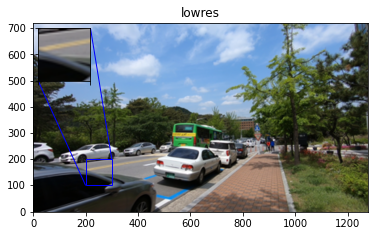

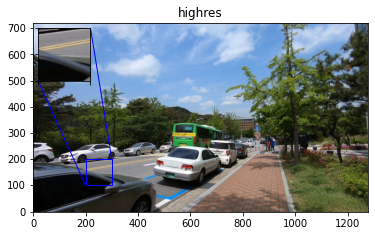

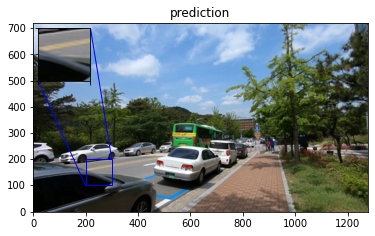

PSNR of low resolution image and high resolution image is 28.9554
SSIM of low resolution image and high resolution image is 0.8546
PSNR of predict and high resolution is 29.7772
PSNR of predict and high resolution is 0.8714


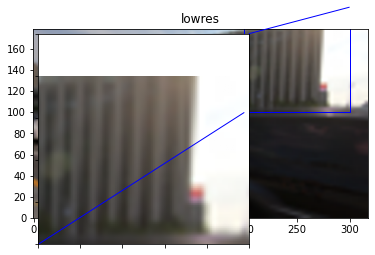

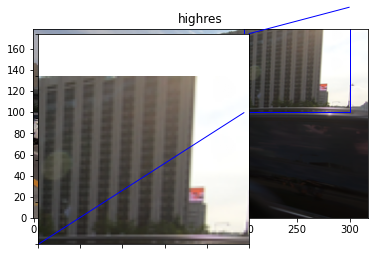

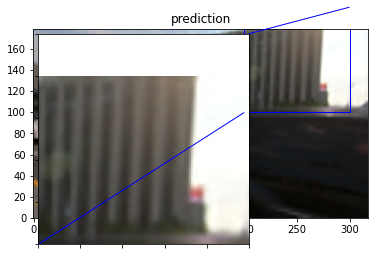

PSNR of low resolution image and high resolution image is 30.3034
SSIM of low resolution image and high resolution image is 0.8718
PSNR of predict and high resolution is 31.2273
PSNR of predict and high resolution is 0.8889


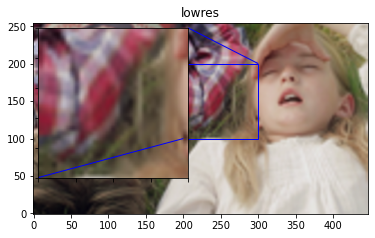

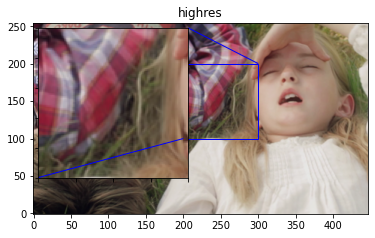

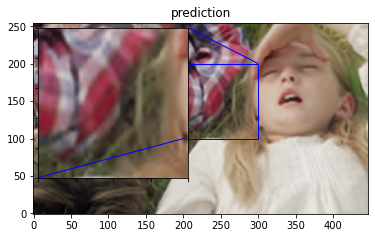

PSNR of low resolution image and high resolution image is 27.9598
SSIM of low resolution image and high resolution image is 0.8803
PSNR of predict and high resolution is 28.8377
PSNR of predict and high resolution is 0.8900


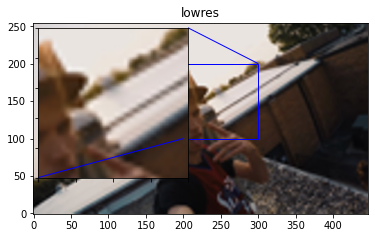

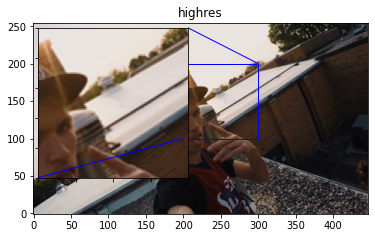

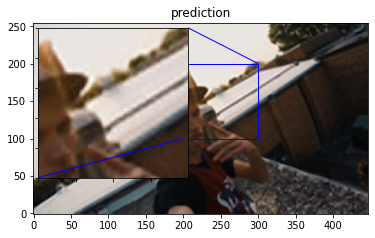

PSNR of low resolution image and high resolution image is 30.3696
SSIM of low resolution image and high resolution image is 0.8740
PSNR of predict and high resolution is 31.2721
PSNR of predict and high resolution is 0.8908


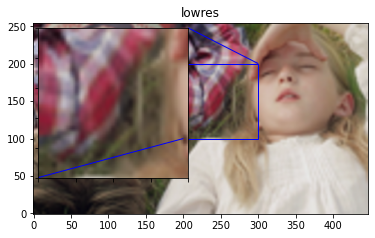

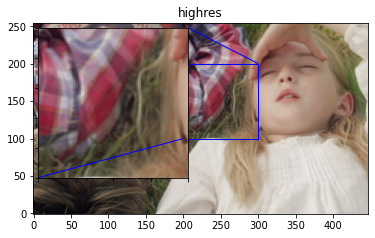

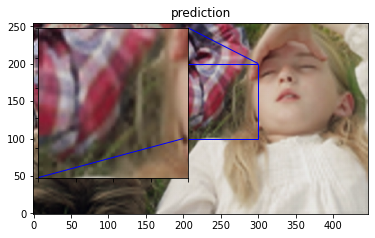

PSNR of low resolution image and high resolution image is 28.3016
SSIM of low resolution image and high resolution image is 0.8881
PSNR of predict and high resolution is 29.1966
PSNR of predict and high resolution is 0.8964


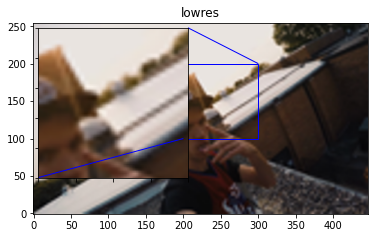

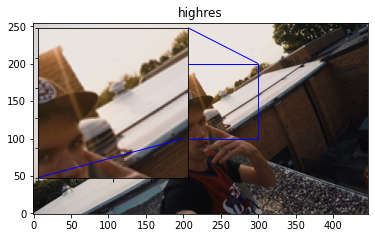

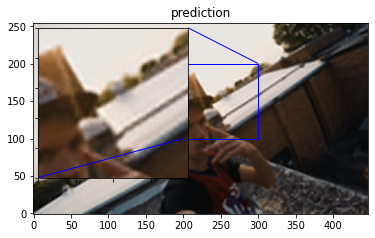

PSNR of low resolution image and high resolution image is 30.4734
SSIM of low resolution image and high resolution image is 0.8772
PSNR of predict and high resolution is 31.3645
PSNR of predict and high resolution is 0.8935


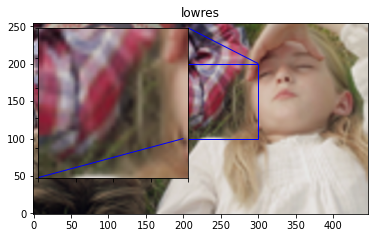

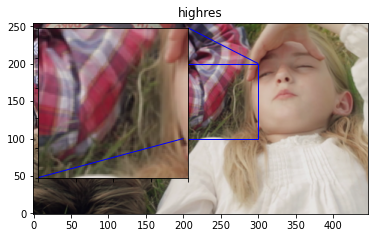

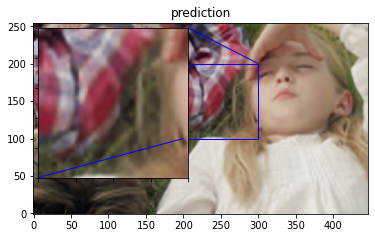

PSNR of low resolution image and high resolution image is 28.4067
SSIM of low resolution image and high resolution image is 0.8912
PSNR of predict and high resolution is 29.3287
PSNR of predict and high resolution is 0.8986


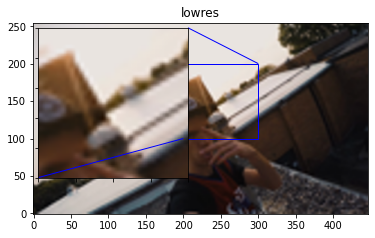

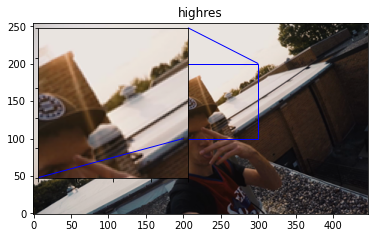

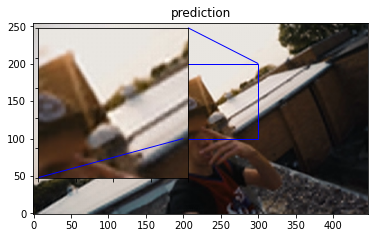

Avg. PSNR of lowres images is 30.4775
Avg. PSNR of reconstructions is 31.1551
Avg. SSIM of lowres images is 0.0000
Avg. SSIM of lowres images is 0.0000


In [27]:
total_bicubic_psnr = 0.0
total_test_psnr = 0.0
total_bicubic_ssim =0.0
total_test_ssim=0.0
for index, test_img_path in enumerate(test_img_paths[0:50]):
    img = load_img(test_img_path)
    lowres_input = get_lowres_image(img, upscale_factor)
    w = lowres_input.size[0] * upscale_factor
    h = lowres_input.size[1] * upscale_factor
    highres_img = img.resize((w, h))
    prediction = upscale_image(model, lowres_input)
    lowres_img = lowres_input.resize((w, h))
    lowres_img_arr = img_to_array(lowres_img)
    highres_img_arr = img_to_array(highres_img)
    predict_img_arr = img_to_array(prediction)
    bicubic_psnr = tf.image.psnr(lowres_img_arr, highres_img_arr, max_val=255)
    bicubic_ssim = tf.image.ssim(lowres_img_arr, highres_img_arr, max_val=255)
    test_psnr = tf.image.psnr(predict_img_arr, highres_img_arr, max_val=255)
    test_ssim = tf.image.ssim(predict_img_arr, highres_img_arr, max_val=255)

    total_bicubic_psnr += bicubic_psnr
    total_test_psnr += test_psnr

    print(
        "PSNR of low resolution image and high resolution image is %.4f" % bicubic_psnr
    )
    print(
        "SSIM of low resolution image and high resolution image is %.4f" % bicubic_ssim
    )
    print("PSNR of predict and high resolution is %.4f" % test_psnr)
    print("PSNR of predict and high resolution is %.4f" % test_ssim)
    plot_results(lowres_img, index, "lowres")
    plot_results(highres_img, index, "highres")
    plot_results(prediction, index, "prediction")

print("Avg. PSNR of lowres images is %.4f" % (total_bicubic_psnr / 50))
print("Avg. PSNR of reconstructions is %.4f" % (total_test_psnr / 50))
print("Avg. SSIM of lowres images is %.4f" % (total_bicubic_ssim / 50))
print("Avg. SSIM of lowres images is %.4f" % (total_bicubic_ssim / 50))